<a href="https://colab.research.google.com/github/tcache1/2022_ML_Earth_Env_Sci/blob/main/ML_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Machine Learning - Final Project**



Developing a model that takes as input 2D precipitation time series (and a DEM) and outputs a flood inundation map of the peak water depth.

# Notebook setup

In [ ]:
import sklearn 
import tensorflow as tf 
from tensorflow import keras
import numpy as np
import xarray as xr
import os

from keras.models import Model, load_model
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from keras.layers.core import Lambda, RepeatVector, Reshape
from keras.layers.convolutional import Conv2D, Conv2DTranspose, Conv3D, Conv3DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D, MaxPooling3D
from keras.layers.merge import concatenate, add
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

# To make this notebook's output stable across runs
rnd_seed = 42
rnd_gen = np.random.default_rng(rnd_seed)

# To plot figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Initialize the run_index
run_index = None

# Loading Tensorboard
%load_ext tensorboard

In [ ]:
assert tf.__version__ == "2.8.0"

# Data setup

We will work with 2D time series (starting with 30 rainfall events at first, can be expanded to more later), with a 5 meters (upscaled to 15m) DEM of the city of Zürich and the computed peak water depths from CADIS.

In [ ]:
# Creating a list containing the name of paths where data are stored
list_of_path_precip = []
for i in list(range(1,11)):
    list_of_path_precip.append(str('drive/MyDrive/ML_final_project/Zurich_CC_')+str(i)+str('.nc'))

for i in list(range(1,11)):    
    list_of_path_precip.append(str('drive/MyDrive/ML_final_project/Zurich_future_')+str(i)+str('.nc'))

#for i in list(range(1,6)):
#    list_of_path_precip.append(str('drive/MyDrive/ML_final_project/Zurich_present_')+str(i+10)+str('.nc'))

for i in list(range(1,11)):
    list_of_path_precip.append(str('drive/MyDrive/ML_final_project/Zurich_QM_')+str(i)+str('.nc'))

In [ ]:
list_of_path_precip

['drive/MyDrive/ML_final_project/Zurich_CC_1.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_2.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_3.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_4.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_5.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_6.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_7.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_8.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_9.nc',
 'drive/MyDrive/ML_final_project/Zurich_CC_10.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_1.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_2.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_3.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_4.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_5.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_6.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_7.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_8.nc',
 'drive/MyDrive/ML_final_project/Zurich_future_9.nc',
 'drive/MyDri

In [ ]:
# Giving access to documents in the drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
os.listdir('/content/drive/MyDrive/ML_final_project/')

['Zurich_DEM.txt',
 'ZH_WDraster_PEAK_11.asc',
 'ZH_WDraster_PEAK_12.asc',
 'ZH_WDraster_PEAK_13.asc',
 'ZH_WDraster_PEAK_14.asc',
 'ZH_WDraster_PEAK_15.asc',
 'ZH_WDraster_PEAK_16.asc',
 'ZH_WDraster_PEAK_17.asc',
 'ZH_WDraster_PEAK_18.asc',
 'ZH_WDraster_PEAK_19.asc',
 'ZH_WDraster_PEAK_20.asc',
 'ZH_WDraster_PEAK_22.asc',
 'ZH_WDraster_PEAK_23.asc',
 'ZH_WDraster_PEAK_41.asc',
 'ZH_WDraster_PEAK_42.asc',
 'ZH_WDraster_PEAK_43.asc',
 'ZH_WDraster_PEAK_44.asc',
 'ZH_WDraster_PEAK_45.asc',
 'ZH_WDraster_PEAK_46.asc',
 'ZH_WDraster_PEAK_47.asc',
 'ZH_WDraster_PEAK_48.asc',
 'ZH_WDraster_PEAK_49.asc',
 'ZH_WDraster_PEAK_50.asc',
 'ZH_WDraster_PEAK_52.asc',
 'ZH_WDraster_PEAK_53.asc',
 'ZH_WDraster_PEAK_71.asc',
 'ZH_WDraster_PEAK_72.asc',
 'ZH_WDraster_PEAK_73.asc',
 'ZH_WDraster_PEAK_74.asc',
 'ZH_WDraster_PEAK_75.asc',
 'ZH_WDraster_PEAK_76.asc',
 'ZH_WDraster_PEAK_77.asc',
 'ZH_WDraster_PEAK_78.asc',
 'ZH_WDraster_PEAK_79.asc',
 'ZH_WDraster_PEAK_80.asc',
 'ZH_WDraster_PEAK_91.asc',
 

In [ ]:
# Saving a dataset because the format of the netcdf does not allow to open the 
# data with 'mf_dataset'
def preprocessing_function_precip(list_of_path_precip):  
    # Initialising the array of precipitation events  
    da = xr.DataArray()
    da = xr.open_dataset(list_of_path_precip[0], decode_times=False)

    # Adding an 'event' dimension to the DataSet
    da.expand_dims('event')

    # Converting to float16 because of memory limitation
    da['pr'] = da['pr'].astype(np.float16)

    # Combining the dataset to include all precipitation events
    for path in list_of_path_precip[1:]:
        print(path)
        ds = xr.open_dataset(path, decode_times=False)
        ds['pr'] = ds['pr'].astype(np.float16)
        da = xr.concat([da, ds],'event')

    # Defining X_pr as the precipitation data from the dataset
    X_pr = da['pr']

    # Choosing only a few snapshots (memory limitations)
    X_pr = X_pr[:,np.arange(0,49,2),:,:]

    # Normalising 
    max_pr = X_pr.max().max()
    min_pr = X_pr.min().min()
    # mean_pr = X_pr.mean().mean()  # mean does not support float16
    # X_pr = (X_pr-mean_pr)/(max_pr-min_pr)  
    X_pr = (X_pr-min_pr)/(max_pr-min_pr) 

    return X_pr
    return max_pr
    return min_pr

In [ ]:
X_pr = preprocessing_function_precip(list_of_path_precip)

drive/MyDrive/ML_final_project/Zurich_CC_2.nc
drive/MyDrive/ML_final_project/Zurich_CC_3.nc
drive/MyDrive/ML_final_project/Zurich_CC_4.nc
drive/MyDrive/ML_final_project/Zurich_CC_5.nc
drive/MyDrive/ML_final_project/Zurich_CC_6.nc
drive/MyDrive/ML_final_project/Zurich_CC_7.nc
drive/MyDrive/ML_final_project/Zurich_CC_8.nc
drive/MyDrive/ML_final_project/Zurich_CC_9.nc
drive/MyDrive/ML_final_project/Zurich_CC_10.nc
drive/MyDrive/ML_final_project/Zurich_future_1.nc
drive/MyDrive/ML_final_project/Zurich_future_2.nc
drive/MyDrive/ML_final_project/Zurich_future_3.nc
drive/MyDrive/ML_final_project/Zurich_future_4.nc
drive/MyDrive/ML_final_project/Zurich_future_5.nc
drive/MyDrive/ML_final_project/Zurich_future_6.nc
drive/MyDrive/ML_final_project/Zurich_future_7.nc
drive/MyDrive/ML_final_project/Zurich_future_8.nc
drive/MyDrive/ML_final_project/Zurich_future_9.nc
drive/MyDrive/ML_final_project/Zurich_future_10.nc
drive/MyDrive/ML_final_project/Zurich_QM_1.nc
drive/MyDrive/ML_final_project/Zurich_

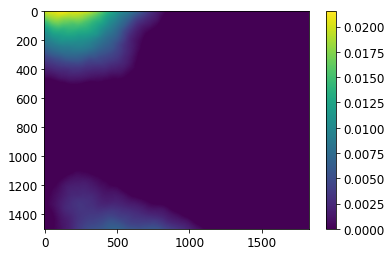

In [ ]:
# Visual inspection of precipitation time series over Zurich
event_nb = 2
time_step = 5
fig, ax = plt.subplots()
ax = plt.imshow(X_pr[event_nb,time_step,:,:].astype(np.float32))
ax = plt.colorbar()

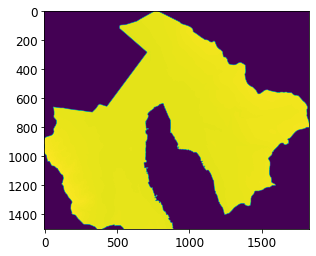

In [ ]:
# Loading the DEM of Zurich. DEM is in .txt format
X_dem = np.loadtxt('drive/MyDrive/ML_final_project/Zurich_DEM.txt', skiprows=6)
plt.imshow(X_dem)

In [ ]:
list_of_path_flood = []
for i in list(range(11,21)):
    list_of_path_flood.append(str('drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_')+str(i)+str('.asc'))

for i in list(range(41,51)):
    list_of_path_flood.append(str('drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_')+str(i)+str('.asc'))

#for i in list(range(71,76)):
#    list_of_path_flood.append(str('drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_')+str(i)+str('.asc'))

for i in list(range(91,101)):
    list_of_path_flood.append(str('drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_')+str(i)+str('.asc'))

In [ ]:
list_of_path_flood

['drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_11.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_12.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_13.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_14.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_15.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_16.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_17.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_18.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_19.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_20.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_41.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_42.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_43.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_44.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_45.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_46.asc',
 'drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_47.asc

In [ ]:
def preprocessing_function_flood(list_of_path_flood):
    # Loading the CADIS computed peak water depth for Event 1
    ds_y = np.loadtxt(list_of_path_flood[0], skiprows=6)

    # Initialising the water depth maps array
    Y = xr.DataArray(data=ds_y,
                    dims=['lat','lon'])
    Y.expand_dims('event')

    # Expanding the water depth map array for all flood events 
    for path in list_of_path_flood[1:]:
        print(path)
        ds_y = xr.DataArray( data=np.loadtxt(path, skiprows=6),
                        dims=['lat','lon'])
        Y = xr.concat([Y, ds_y],'event')

    return(Y)

In [ ]:
Y = preprocessing_function_flood(list_of_path_flood)

drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_12.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_13.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_14.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_15.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_16.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_17.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_18.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_19.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_20.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_41.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_42.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_43.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_44.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_45.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_46.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_47.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_48.asc
drive/MyDrive/ML_final_project/ZH_WDraster_PEAK_49.asc
drive/MyDr

In [ ]:
# Min-max normalisation
max_y = Y.max().max()
min_y = Y.min().min()
Y = (Y-min_y)/(max_y-min_y)

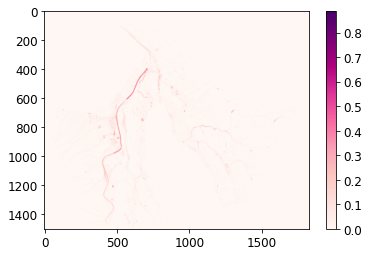

In [ ]:
# Visual inspection of flood over Zurich
event_nb = 8
fig, ax = plt.subplots()
ax = plt.imshow(Y[event_nb,:,:].astype(np.float32),cmap='RdPu')
ax = plt.colorbar()

In [ ]:
# Maximum precipitation in each event 
# X_pr.max(dim=['time','lat','lon'])

# Resize the images

In [ ]:
# resize the images because 
# 1. GPU limitations
# 2. The built architecture does not work with input that are not of size (2^n)*(2^n)
X_pr_coarse = X_pr.coarsen({'lat':3,'lon':3}).mean().isel(lon=range(512))
X_pr_coarse = X_pr_coarse.pad(lat=(0,12), constant_values=0)
X_pr_coarse.values.shape

(30, 25, 512, 512)

# Adding the DEM as input

In [ ]:
# Normalisation of the DEM
X_dem[X_dem==-9999] = 0
X_dem_norm = (X_dem-X_dem.min().min())/(X_dem.max().max()-X_dem.min().min())

In [ ]:
type(X_dem_norm)

numpy.ndarray

In [ ]:
# Converting to DataArry to be able to concatenate with precipitation inputs
X_dem_xr = xr.DataArray(
    X_dem_norm, 
    dims={'lat':'dim_0','lon':'dim_1'})

In [ ]:
X_dem_xr

<xarray.DataArray (lat: 1500, lon: 1824)>
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])
Dimensions without coordinates: lat, lon

In [ ]:
X_dem_xr = X_dem_xr.assign_coords(lat=("lat", X_pr.lat.values))
X_dem_xr = X_dem_xr.assign_coords(lon=("lon", X_pr.lon.values))

In [ ]:
X_dem_xr = X_dem_xr.expand_dims('time')

In [ ]:
X_dem_xr = X_dem_xr.assign_coords(time=('time', [0]))

In [ ]:
X_dem_xr

<xarray.DataArray (time: 1, lat: 1500, lon: 1824)>
array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])
Coordinates:
  * lat      (lat) float32 1.25e+06 1.25e+06 1.25e+06 ... 1.243e+06 1.243e+06
  * lon      (lon) float32 2.679e+06 2.679e+06 2.679e+06 ... 2.689e+06 2.689e+06
  * time     (time) int64 0

In [ ]:
X_dem_coarse = X_dem_xr.coarsen({'lat':3,'lon':3}).mean().isel(lon=range(512))
X_dem_coarse = X_dem_coarse.pad(lat=(0,12), constant_values=0)
X_dem_coarse.values.shape

(1, 512, 512)

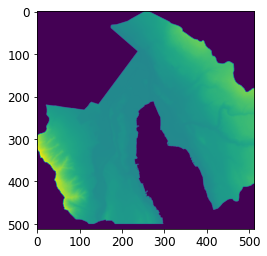

In [ ]:
plt.imshow(X_dem_coarse[0,:,:])

In [ ]:
X_dem_ev = X_dem_coarse
#for i in range(len(X_pr[0,:,0,0])-1):
#        X_dem_ev = xr.concat([X_dem_ev, X_dem_coarse],'time')

In [ ]:
X_dem_ev 

<xarray.DataArray (time: 1, lat: 512, lon: 512)>
array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])
Coordinates:
  * lat      (lat) float32 1.25e+06 1.25e+06 1.25e+06 1.25e+06 ... nan nan nan
  * lon      (lon) float32 2.679e+06 2.679e+06 2.679e+06 ... 2.687e+06 2.687e+06
  * time     (time) int64 0

In [ ]:
X_pr_coarse = xr.concat([X_dem_ev, X_pr_coarse],'time')

In [ ]:
X_pr_coarse

<xarray.DataArray (time: 26, lat: 512, lon: 512, event: 30)>
array([[[[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],

        [[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
...
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],

        [[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]]]])
Coordinates:
  * lat      (lat) float32 1.25e+06 1.25e+06 1.25e+06 1.25e+06 ... nan nan nan
  * lon      (lon) float32 2.679e+06 2.679e+06 2.679e+06 ... 2.687e+06 2.687e+06
  * time     (time) float64 0.0 300.0 900.0 ... 1.35e+04 1.41e+04 1.47e+04
Dimensions without coordinates: event

# End of addition of DEM

In [ ]:
# resize the images (same reasons as before)
Y_coarse = Y.coarsen({'lat':3,'lon':3}).mean().isel(lon=range(512))
Y_coarse = Y_coarse.pad(lat=(0,12), constant_values=0)
Y_coarse.values.shape

(30, 512, 512)

In [ ]:
# Moving axis to have event, lat, lon, time
X_as_numpy = np.moveaxis(X_pr_coarse.values,0,-2)
X_as_numpy = np.moveaxis(X_as_numpy,-1,0)
X_as_numpy.shape

Y_as_numpy = Y_coarse.values
Y_as_numpy.shape

(30, 512, 512)

In [ ]:
X_as_numpy.shape

(30, 512, 512, 26)

# Splitting dataset


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
# Setting the test set to 10% of data
X_train, X_test, y_train, y_test = train_test_split(X_as_numpy, Y_as_numpy, test_size = 0.1)

# Model without DEM

In [ ]:
def get_CNN_logdir():
    time = np.datetime64('now').astype(str)[:-3]
    run_logdir = os.path.join(os.curdir, "CNN_logs", f"run_{time}") # time goes in the fstring
    return run_logdir

In [ ]:
np.datetime64('now').astype(str)[:-3]

'2022-05-24T17:09'

In [ ]:
get_CNN_logdir()

'./CNN_logs/run_2022-05-24T17:09'

In [ ]:
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=8)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("UNet.h5", 
                                                   save_best_only=True,
                                                   monitor='val_loss')
tensorboard_cb = tf.keras.callbacks.TensorBoard(get_CNN_logdir())

In [ ]:
keras.backend.clear_session()
tf.random.set_seed(rnd_seed)
np.random.seed(rnd_seed)

In [ ]:
def build_model(input_layer, start_neurons, kernel, dropout_rate):
    conv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(input_layer)
    #conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(conv1)
    #conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D((2, 2))(conv1)
    pool1 = Dropout(dropout_rate)(pool1)

    conv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(pool1)
    #conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(conv2)
    #conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D((2, 2))(conv2)
    pool2 = Dropout(dropout_rate)(pool2)

    conv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(pool2)
    #conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(conv3)
    #conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D((2, 2))(conv3)
    pool3 = Dropout(dropout_rate)(pool3)

    conv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(pool3)
    #conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(conv4)
    #conv4 = BatchNormalization()(conv4)
    pool4 = MaxPooling2D((2, 2))(conv4)
    pool4 = Dropout(dropout_rate)(pool4)

    # Middle
    convm = Conv2D(start_neurons * 16, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(pool4)
    #convm = BatchNormalization()(convm)
    convm = Conv2D(start_neurons * 16, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(convm)
    #convm = BatchNormalization()(convm)
    
    deconv4 = Conv2DTranspose(start_neurons * 8, (kernel, kernel), strides=(2, 2), padding='same')(convm)
    uconv4 = concatenate([deconv4, conv4])
    uconv4 = Dropout(dropout_rate)(uconv4)
    uconv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv4)
    #uconv4 = BatchNormalization()(uconv4)
    uconv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv4)
    #uconv4 = BatchNormalization()(uconv4)

    deconv3 = Conv2DTranspose(start_neurons * 4, (kernel, kernel), strides=(2, 2), padding='same')(uconv4)
    uconv3 = concatenate([deconv3, conv3])
    uconv3 = Dropout(dropout_rate)(uconv3)
    uconv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv3)
    #uconv3 = BatchNormalization()(uconv3)
    uconv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv3)
    #uconv3 = BatchNormalization()(uconv3)

    deconv2 = Conv2DTranspose(start_neurons * 2, (kernel, kernel), strides=(2, 2), padding='same')(uconv3)
    uconv2 = concatenate([deconv2, conv2])
    uconv2 = Dropout(dropout_rate)(uconv2)
    uconv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv2)
    #uconv2 = BatchNormalization()(uconv2)
    uconv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv2)
    #uconv2 = BatchNormalization()(uconv2)

    deconv1 = Conv2DTranspose(start_neurons * 1, (kernel, kernel), strides=(2, 2), padding='same')(uconv2)
    uconv1 = concatenate([deconv1, conv1])
    uconv1 = Dropout(dropout_rate)(uconv1)
    uconv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv1)
    #uconv1 = BatchNormalization()(uconv1)
    uconv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='relu', padding='same', kernel_initializer = 'glorot_uniform')(uconv1)
    #uconv1 = BatchNormalization()(uconv1)
    
    output_layer = Conv2D(1, (1,1), padding='same', activation='softplus')(uconv1)
    model = Model(inputs=[input_layer], outputs=[output_layer])
    
    return model

In [ ]:
def build_model_SELU(input_layer, start_neurons, kernel, dropout_rate):
    conv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(input_layer)
    #conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(conv1)
    #conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D((2, 2))(conv1)
    pool1 = Dropout(dropout_rate)(pool1)

    conv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(pool1)
    #conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(conv2)
    #conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D((2, 2))(conv2)
    pool2 = Dropout(dropout_rate)(pool2)

    conv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(pool2)
    #conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(conv3)
    #conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D((2, 2))(conv3)
    pool3 = Dropout(dropout_rate)(pool3)

    conv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(pool3)
    #conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(conv4)
    #conv4 = BatchNormalization()(conv4)
    pool4 = MaxPooling2D((2, 2))(conv4)
    pool4 = Dropout(dropout_rate)(pool4)

    # Middle
    convm = Conv2D(start_neurons * 16, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(pool4)
    #convm = BatchNormalization()(convm)
    convm = Conv2D(start_neurons * 16, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(convm)
    #convm = BatchNormalization()(convm)
    
    deconv4 = Conv2DTranspose(start_neurons * 8, (kernel, kernel), strides=(2, 2), padding='same')(convm)
    uconv4 = concatenate([deconv4, conv4])
    uconv4 = Dropout(dropout_rate)(uconv4)
    uconv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv4)
    #uconv4 = BatchNormalization()(uconv4)
    uconv4 = Conv2D(start_neurons * 8, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv4)
    #uconv4 = BatchNormalization()(uconv4)

    deconv3 = Conv2DTranspose(start_neurons * 4, (kernel, kernel), strides=(2, 2), padding='same')(uconv4)
    uconv3 = concatenate([deconv3, conv3])
    uconv3 = Dropout(dropout_rate)(uconv3)
    uconv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv3)
    #uconv3 = BatchNormalization()(uconv3)
    uconv3 = Conv2D(start_neurons * 4, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv3)
    #uconv3 = BatchNormalization()(uconv3)

    deconv2 = Conv2DTranspose(start_neurons * 2, (kernel, kernel), strides=(2, 2), padding='same')(uconv3)
    uconv2 = concatenate([deconv2, conv2])
    uconv2 = Dropout(dropout_rate)(uconv2)
    uconv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv2)
    #uconv2 = BatchNormalization()(uconv2)
    uconv2 = Conv2D(start_neurons * 2, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv2)
    #uconv2 = BatchNormalization()(uconv2)

    deconv1 = Conv2DTranspose(start_neurons * 1, (kernel, kernel), strides=(2, 2), padding='same')(uconv2)
    uconv1 = concatenate([deconv1, conv1])
    uconv1 = Dropout(dropout_rate)(uconv1)
    uconv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv1)
    #uconv1 = BatchNormalization()(uconv1)
    uconv1 = Conv2D(start_neurons * 1, (kernel, kernel), activation='selu', padding='same', kernel_initializer = 'lecun_normal')(uconv1)
    #uconv1 = BatchNormalization()(uconv1)
    
    output_layer = Conv2D(1, (1,1), padding='same', activation='relu')(uconv1)
    model = Model(inputs=[input_layer], outputs=[output_layer])
    
    return model

In [ ]:
input_layer = Input(shape=(512, 512, 25)) 
model = build_model(input_layer, 16, 1, 0.25)
model.compile(loss='mse',
              optimizer='adam',
              metrics=[tf.keras.metrics.MeanAbsoluteError()])

In [ ]:
X_train[:,:,:,range(25)].shape

(27, 512, 512, 25)

In [ ]:
history=model.fit(X_train[:,:,:,range(25)], 
                  y=y_train, 
                  epochs=100, 
                  validation_split=0.10, 
                  callbacks=[early_stopping_cb,
                            checkpoint_cb,
                            tensorboard_cb])

Epoch 1/100
1/1 [==============================] - 16s 16s/step - loss: 0.4747 - mean_absolute_error: 0.6887 - val_loss: 0.4506 - val_mean_absolute_error: 0.6708
Epoch 2/100
1/1 [==============================] - 1s 914ms/step - loss: 0.4669 - mean_absolute_error: 0.6830 - val_loss: 0.4400 - val_mean_absolute_error: 0.6627
Epoch 3/100
1/1 [==============================] - 1s 914ms/step - loss: 0.4587 - mean_absolute_error: 0.6769 - val_loss: 0.4298 - val_mean_absolute_error: 0.6549
Epoch 4/100
1/1 [==============================] - 1s 937ms/step - loss: 0.4502 - mean_absolute_error: 0.6706 - val_loss: 0.4198 - val_mean_absolute_error: 0.6472
Epoch 5/100
1/1 [==============================] - 1s 972ms/step - loss: 0.4416 - mean_absolute_error: 0.6640 - val_loss: 0.4100 - val_mean_absolute_error: 0.6394
Epoch 6/100
1/1 [==============================] - 1s 871ms/step - loss: 0.4327 - mean_absolute_error: 0.6572 - val_loss: 0.4003 - val_mean_absolute_error: 0.6317
Epoch 7/100
1/1 [======

# Model with DEM

In [ ]:
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=8)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("UNet_DEM.h5", 
                                                   save_best_only=True,
                                                   monitor='val_loss')
tensorboard_cb = tf.keras.callbacks.TensorBoard(get_CNN_logdir())

In [ ]:
keras.backend.clear_session()
tf.random.set_seed(rnd_seed)
np.random.seed(rnd_seed)

In [ ]:
input_layer = Input(shape=(512, 512, 26))  
model_DEM = build_model(input_layer, 16, 1, 0.25)
model_DEM.compile(loss='mse',
              optimizer='adam',
              metrics=[tf.keras.metrics.MeanAbsoluteError()]) # tf.keras.metrics.RootMeanSquaredError()

In [ ]:
history=model_DEM.fit(X_train, 
                  y=y_train, 
                  epochs=100, 
                  validation_split=0.10, 
                  callbacks=[early_stopping_cb,
                            checkpoint_cb,
                            tensorboard_cb])

Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 0.4747 - mean_absolute_error: 0.6887 - val_loss: 0.4508 - val_mean_absolute_error: 0.6709
Epoch 2/100
1/1 [==============================] - 1s 868ms/step - loss: 0.4669 - mean_absolute_error: 0.6830 - val_loss: 0.4402 - val_mean_absolute_error: 0.6629
Epoch 3/100
1/1 [==============================] - 1s 873ms/step - loss: 0.4587 - mean_absolute_error: 0.6769 - val_loss: 0.4300 - val_mean_absolute_error: 0.6551
Epoch 4/100
1/1 [==============================] - 1s 876ms/step - loss: 0.4503 - mean_absolute_error: 0.6707 - val_loss: 0.4201 - val_mean_absolute_error: 0.6474
Epoch 5/100
1/1 [==============================] - 1s 897ms/step - loss: 0.4417 - mean_absolute_error: 0.6641 - val_loss: 0.4104 - val_mean_absolute_error: 0.6397
Epoch 6/100
1/1 [==============================] - 1s 904ms/step - loss: 0.4328 - mean_absolute_error: 0.6573 - val_loss: 0.4007 - val_mean_absolute_error: 0.6320
Epoch 7/100
1/1 [========

In [ ]:
%tensorboard --logdir=./CNN_logs --port=6006

<IPython.core.display.Javascript object>

# Testing the model 

In [ ]:
# Loading the models
UNet_model = keras.models.load_model('UNet.h5')
UNet_model_DEM = keras.models.load_model('UNet_DEM.h5')

# Test it on the testing dataset
UNet_model.evaluate(X_test[:,:,:,range(25)], y=y_test)
UNet_model_DEM.evaluate(X_test, y=y_test)

1/1 [==============================] - 0s 318ms/step - loss: 0.0030 - mean_absolute_error: 0.0439


[0.0030486851464957, 0.043897565454244614]

In [ ]:
X_test.shape

(3, 512, 512, 26)

# Making predictions

In [ ]:
y_pred = UNet_model.predict(X_test[:,:,:,range(25)])
y_pred_DEM = UNet_model_DEM.predict(X_test)
y_pred.shape

(3, 512, 512, 1)

In [ ]:
y_pred[0,:,:,0].shape

(512, 512)

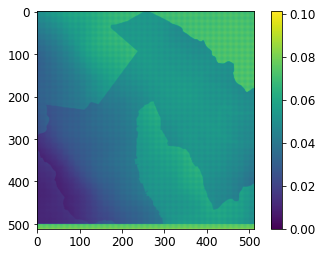

In [ ]:
fig, ax = plt.subplots()
ax = plt.imshow(y_pred[0,:,:,0].astype(np.float32))
ax = plt.colorbar()

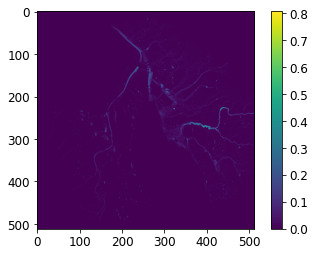

In [ ]:
fig, ax = plt.subplots()
ax = plt.imshow(y_train[0,:,:].astype(np.float32))
ax = plt.colorbar()

# ECDF

In [ ]:
#import plotly.express as px
y_ecdf0 = y_pred[1,:,:,0].astype(np.float32).ravel()
y_ecdf1 = y_pred_DEM[1,:,:,0].astype(np.float32).ravel()
y_ecdf2 = y_train[1,:,:].astype(np.float32).ravel()
y_ecdf = np.zeros((512*512,3))

y_ecdf[:,0] = y_ecdf0
y_ecdf[:,1] = y_ecdf1
y_ecdf[:,2] = y_ecdf2

In [ ]:
import plotly.express as px

In [ ]:
fig = px.ecdf(y_ecdf,labels=['Simulated','Input'])
fig.show()